In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
import cv2
from tqdm import tqdm
import os

np.random.seed(1234)

In [2]:
TRAIN_IMAGES_PATH = "contest01_data/train/images/"
NUM_IMAGES_TO_SHOW = 100
NUM_COLS = 4
NUM_ROWS = NUM_IMAGES_TO_SHOW // NUM_COLS

In [3]:
def draw_landmarks(image, landmarks):
    for point in landmarks:
        x, y = point.astype(np.int)
        cv2.circle(image, (x, y), 1, (128, 0, 128), 2, -1)
    return image

In [4]:
landmarks = pd.read_csv("contest01_data/train/landmarks.csv", sep='\t')

In [5]:
landmarks.head()

,file_name,Point_0_X,Point_0_Y,Point_1_X,Point_1_Y,Point_2_X,Point_2_Y,Point_3_X,Point_3_Y,Point_4_X,...,Point_966_X,Point_966_Y,Point_967_X,Point_967_Y,Point_968_X,Point_968_Y,Point_969_X,Point_969_Y,Point_970_X,Point_970_Y
0,07c5e48d938e8d82c0f10973d66183f3.jpg,162,311,159,311,156,311,152,311,149,...,125,254,124,254,123,254,112,163,191,166
1,28e70684d6e2d6d75a6d3a973e4d4d93.jpg,90,376,89,375,85,374,84,374,82,...,87,307,85,309,87,310,96,202,162,203
2,e7696776dc7b15ca3fa80d4332443e96.jpg,123,210,121,210,119,211,117,211,115,...,98,175,97,175,95,176,80,119,128,115
3,199668f481aa5794c28657bace02fd84.jpg,109,203,107,203,105,203,103,203,101,...,75,159,73,158,73,157,75,107,129,106
4,9ebb7d722fa1cece4fa0d7b2fd39b399.jpg,59,127,58,126,56,126,55,126,53,...,44,92,43,91,43,91,58,61,84,68


In [6]:
iteration = 478

/tmp/ipykernel_13339/2526261039.py:3: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  x, y = point.astype(np.int)


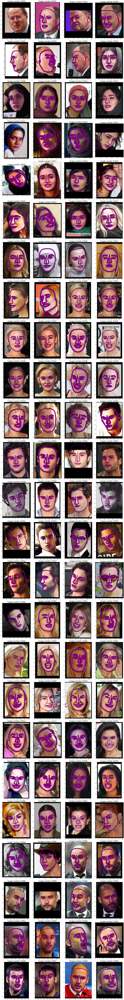

In [7]:
plt.figure(figsize=(25, NUM_ROWS * 8))
iteration += 1
shift = iteration * NUM_IMAGES_TO_SHOW
for i in range(shift, NUM_IMAGES_TO_SHOW + shift):
    fname = landmarks.iloc[i, 0]
    image = cv2.imread(TRAIN_IMAGES_PATH + fname)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = draw_landmarks(image, landmarks.iloc[i, 1:].values.reshape(971, 2))
    
    plt.subplot(NUM_ROWS, NUM_COLS, i+1-shift)
    plt.imshow(image)
    plt.title('Image number {}'.format(i), fontsize=24)
    
plt.tight_layout()
plt.show()

/tmp/ipykernel_8421/2526261039.py:3: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  x, y = point.astype(np.int)


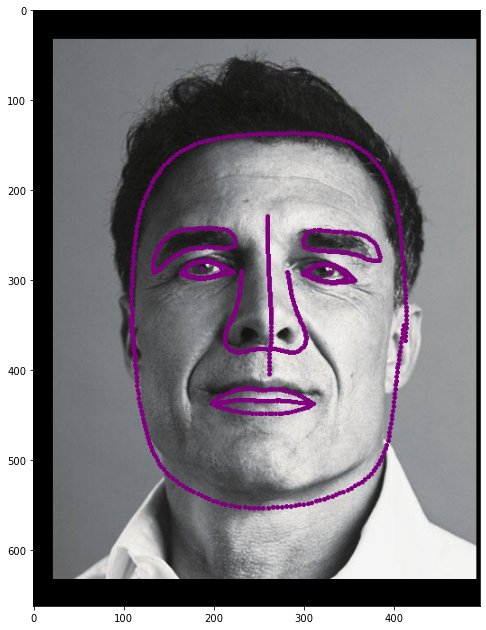

In [7]:
# View single image

ind = 4039
plt.figure(figsize=(8, 12))
fname_check = landmarks.iloc[ind, 0]
image_check = cv2.imread(TRAIN_IMAGES_PATH + fname_check)
image_check = draw_landmarks(image_check, landmarks.iloc[ind, 1:].values.reshape(971, 2))
plt.imshow(image_check)

In [142]:
# Adjust both coord

for i, im in enumerate(bad_images):
    landmarks.iloc[im, 1:] -= 4  

In [137]:
# Adjust y coord

for i, im in enumerate(bad_images):
    for j in range(1, len(landmarks.iloc[im, 1:])):
        if j % 2 == 0: 
            landmarks.iloc[im, j] -= 5 

In [74]:
# Adjust x coord

for i, im in enumerate(bad_images):
    for j in range(1, len(landmarks.iloc[im, 1:])):
        if j % 2 != 0: 
            landmarks.iloc[im, j] -= 3 

In [139]:
bad_images = [54160, 54701, 54825, 54963,
             58938,    
             63035, 63673]

In [140]:
len(bad_images)

7

/tmp/ipykernel_4460/2526261039.py:3: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  x, y = point.astype(np.int)


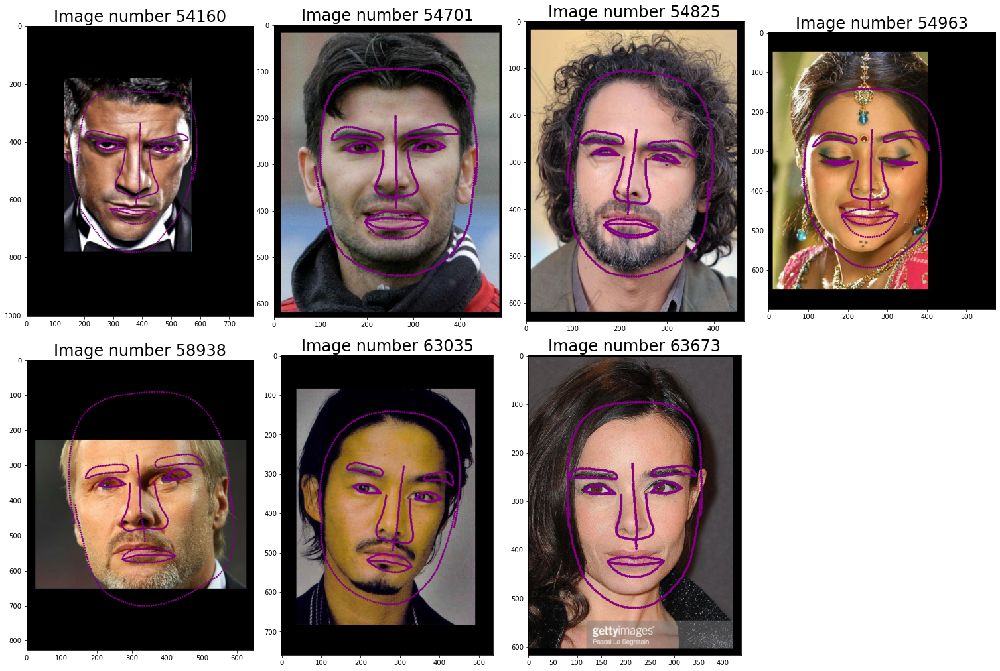

In [143]:
plt.figure(figsize=(21, NUM_ROWS * 7))
for i, im in enumerate(bad_images):
    fname = landmarks.iloc[im, 0]
    image = cv2.imread(TRAIN_IMAGES_PATH + fname)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = draw_landmarks(image, landmarks.iloc[im, 1:].values.reshape(971, 2))
    
    plt.subplot(NUM_ROWS, NUM_COLS, i+1)
    plt.imshow(image)
    plt.title('Image number {}'.format(im), fontsize=24)
    
plt.tight_layout()
plt.show()

In [144]:
landmarks.to_csv("contest01_data/train/landmarks.csv", sep='\t', index=None)

In [145]:
landmarks_check = pd.read_csv("contest01_data/train/landmarks.csv", sep='\t')

In [146]:
landmarks_check.head()

,file_name,Point_0_X,Point_0_Y,Point_1_X,Point_1_Y,Point_2_X,Point_2_Y,Point_3_X,Point_3_Y,Point_4_X,...,Point_966_X,Point_966_Y,Point_967_X,Point_967_Y,Point_968_X,Point_968_Y,Point_969_X,Point_969_Y,Point_970_X,Point_970_Y
0,07c5e48d938e8d82c0f10973d66183f3.jpg,162,311,159,311,156,311,152,311,149,...,125,254,124,254,123,254,112,163,191,166
1,28e70684d6e2d6d75a6d3a973e4d4d93.jpg,90,376,89,375,85,374,84,374,82,...,87,307,85,309,87,310,96,202,162,203
2,e7696776dc7b15ca3fa80d4332443e96.jpg,123,210,121,210,119,211,117,211,115,...,98,175,97,175,95,176,80,119,128,115
3,199668f481aa5794c28657bace02fd84.jpg,109,203,107,203,105,203,103,203,101,...,75,159,73,158,73,157,75,107,129,106
4,9ebb7d722fa1cece4fa0d7b2fd39b399.jpg,59,127,58,126,56,126,55,126,53,...,44,92,43,91,43,91,58,61,84,68
